In [1]:
import matplotlib as mpl
import matplotlib.pyplot as plt
import time
import numpy as np
from PIL import Image

import time

%matplotlib inline

**Harris Corner Detection**

$$\begin{align*}
E(u,v)&=\sum_{(x,y)\in W}[I(x+u,y+v)-I(x,y)]^2 \\
&\approx \sum_{(x,y)\in W}[I(x,y)+I_xu+I_yv-I(x,y)^2] \\
&\approx \sum_{(x,y)\in W}[I_Xu+I_yv]^2 \\
&\approx Au^2+2Buv+Cv^2 \\ 
&\approx \begin{bmatrix}
 u&v
\end{bmatrix}
\begin{bmatrix}
A & B\\ 
B & C
\end{bmatrix}
\begin{bmatrix}
 u \\ 
 v 
\end{bmatrix}
\end{align*}$$

$$A=\sum_{(x,y)\in W}I_x^2 \;\;\;\; B=\sum_{(x,y)\in W}I_xI_y \;\;\;\; C=\sum_{(x,y)\in W}I_y^2$$

**Type0: Eigen Value**
$$  Ax = \lambda x $$
$$  det(A-\lambda I ) =0 $$



**Type1: Harris Operator(h)**
$$ h = \frac{det(H)}{trace(H)} = \frac{AC-B^{2}}{A+C} $$

## 1. Implement corner detectors both on the minimum Eigenvalue and the Harrish *h* measure

### Convert GIF to PNG and Read image

shape : (369, 369, 4) 
changed img shape:(369, 369)


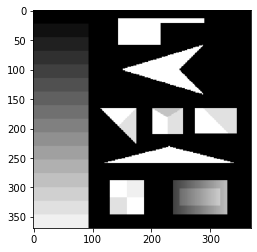

In [3]:
def rgb2gray(rgb):
    if len(rgb.shape)==3:
        return np.dot(rgb[...,:3], [0.299, 0.587, 0.114])
    else:
        print("Current image Channel is not 3!")
        return rgb


img_name = 'img74'
img_gif =  Image.open(img_name+'.gif')
img_gif.save(img_name+".png",'png')

img = plt.imread(img_name+'.png')
print('shape : {} '.format(img.shape))
plt.imshow(img)

img = plt.imread('img74.png')
img = rgb2gray((img))
print('changed img shape:{}'.format(img.shape))

### Define conv() for sobel filtering
conv() gets image and sobel filter as input and return image processed with sobel filter.

In [3]:
def conv(img, weights):
    weights = weights.astype(float)
    filtered = np.zeros_like(img)
    width = int((weights.shape[1]-1)/2)
    height = int((weights.shape[0]-1)/2)
    
    for i in range(height,img.shape[1]-height):
        for j in range(width,img.shape[0]-width):
            filtered[j,i]=np.sum(weights*img[j-width:j+width+1,i-height:i+height+1])
    
    return filtered

### Define cornerDetect()
Image is filtered by sobel filters to get image gradients. When filtering is done, we calculate matrix H by sliding window. 

Elements in matrix H over thershold($\theta$) are regarded as corner. In this function, 2 types of corner detection is available.

Eigenvalue method uses minimum eiguevalue($\lambda_1$) as underbound of deciding corner and Harris operator uses simplified equation for detecting corners.

In [4]:
def cornerDetect(img, winSize, type):
    """
    img: image
    winSize: total size of window for summation in pixels
    type = {0 - EigenValue, 1 - Harris}
    """
    # sobel filter for x
    sobel_x = np.array([(-1,0,1),
                        (-2,0,2),
                        (-1,0,1)])

    # sobel filter for y
    sobel_y = np.array([(-1,-2,-1),
                        (0,0,0),
                        (1,2,1)])

    # convolution
    imgdx = conv(img, sobel_x * 1/8)
    imgdy = conv(img, sobel_y * 1/8)

    # matrix for corner strength
    h = np.zeros_like(img)
    # eigenvalue as corner strength
    l1 = np.zeros_like(img)

    # Ixx, Iyy, Ixy
    ix2 = imgdx*imgdx
    iy2 = imgdy*imgdy
    ixy = imgdx*imgdy

    # threshold
    threshold = 1

    # Corner Detection
    for y in range(winSize, img.shape[0]-winSize-1):
        for x in range(winSize, img.shape[1]-winSize-1):
            sx2 = np.sum(ix2[y-winSize:y+winSize, x-winSize:x+winSize])
            sy2 = np.sum(iy2[y-winSize:y+winSize, x-winSize:x+winSize])
            sxy = np.sum(ixy[y-winSize:y+winSize, x-winSize:x+winSize])
            
            tmp_h = np.array([(sx2,sxy),(sxy,sy2)])
            
            # Using Min Eigenvalue
            if type == 0: 
                l1[y,x], _ = np.sort(np.linalg.eigvals(tmp_h))
                corner = np.where(l1 > threshold, l1, 0)
            
            # Using Harris Operator
            elif type == 1:
                if np.trace(tmp_h) != 0:
                    h[y,x] = np.linalg.det(tmp_h)/np.trace(tmp_h)
                corner = np.where(h > threshold, h, 0)

    return corner


## 2. Test the picture with window sizes for both types of corner measures and TIME the speed
- detect corner
- measure the execution time

In [5]:
# winSize to experiment
winSize_list = [3, 5, 7, 9, 11, 15, 21]

corner_list = []

# to check runtime for each method
time_eigen = []
time_harris = []

for t in [0,1]:
    print('type {} has selected'.format(t))
    for i,j in enumerate(winSize_list):
        print('processing winSize {}'.format(j))

        # the runtime is checked
        start = time.time()
        corner = cornerDetect(img, winSize=j, type=t)
        total_time = time.time() - start

        if t == 0:
            time_eigen.append(total_time)
        elif t == 1:
            time_harris.append(total_time)
        else:
            print('type error')

        # to save coordinate for corners
        temp = []
        for k in range(len(corner)):
            for g in range(len(corner)):
                if corner[k][g] > 0:
                    temp.append([k,g])
        
        temp = np.array(temp)

        corner_list.append(temp)

type 0 has selected
processing winSize 3
processing winSize 5
processing winSize 7
processing winSize 9
processing winSize 11
processing winSize 15
processing winSize 21
type 1 has selected
processing winSize 3
processing winSize 5
processing winSize 7
processing winSize 9
processing winSize 11
processing winSize 15
processing winSize 21


### 1) Compare the picture with window sizes for both types of corner measures

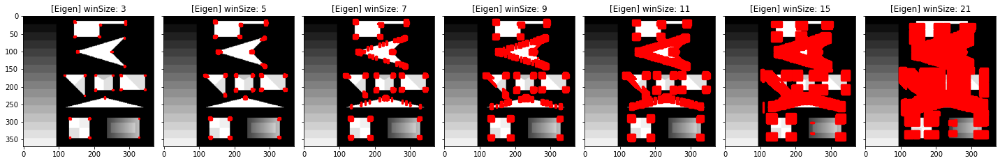

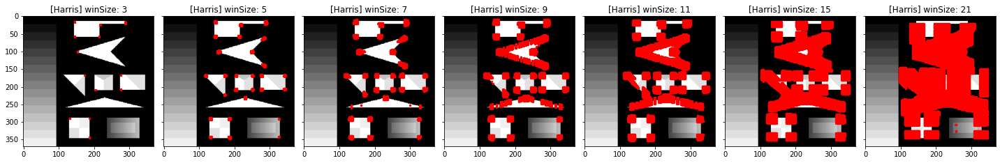

In [7]:
img = plt.imread('img74.png')
img = rgb2gray((img))

# plot result of using eigenvalue
fig, ax = plt.subplots(1,7, figsize=(20,10), sharey=True)
for i, k in enumerate(corner_list[:7]):
    ax[i].imshow(img, cmap = 'gray')
    ax[i].scatter(k[:,1], k[:,0], marker='o', c= 'r', s=5)
    ax[i].set_title('[Eigen] winSize: {}'.format(winSize_list[i]))
plt.tight_layout()

# plot result of harris corner detection
fig, ax = plt.subplots(1,7, figsize=(20,10), sharey=True)
for i, k in enumerate(corner_list[7:]):
    ax[i].imshow(img, cmap = 'gray')
    ax[i].scatter(k[:,1], k[:,0], marker='o', c= 'r', s=5)
    ax[i].set_title('[Harris] winSize: {}'.format(winSize_list[i]))

plt.tight_layout()
plt.show()

### 2) Compare the picture with window sizes for time the speed

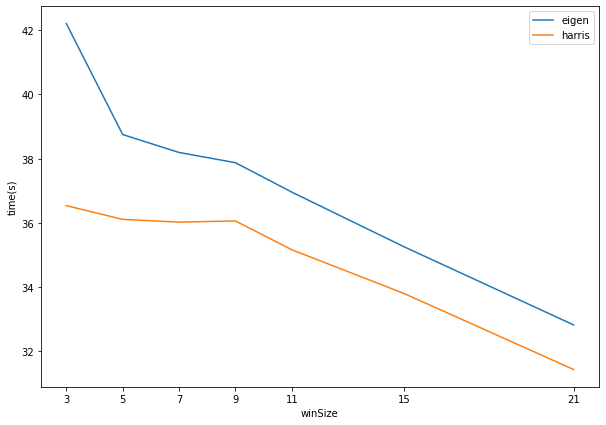

In [8]:
plt.figure(figsize=(10,7))
plt.plot(winSize_list,time_eigen)
plt.plot(winSize_list, time_harris)

plt.xticks(winSize_list)
plt.xlabel('winSize')
plt.ylabel('time(s)')


plt.legend(['eigen','harris'])

## 3. Answer the following questions

### 1) At which window sizes can you detect all 'meaningful corners'?

According to the experiment 1), all meaningful corners are detected at window size 7.  

31 corners exist in this given image and the number of detected corners changes depend on window size.

When size of window is smaller than 7, about 4 corners are missing in detected corner list.

In case of window size over 7, too many corners are detected so that even some points on edge are included. 

With window size 7, all detection method can find most of corners and in detected corner list, less point on edge are found.

For these reasons, our team decide that at window size 7, both algorithms show the best performance on corner deetection.

### 2) Which method is faster - Eigenvalue or Harris? By how much?

Harris corner detection is 1.02~1.2 times faster than method based on eigenvalue.

Experiment 2) shows comparison about execution time between eigenvalue method and harris detection.

Harris operator is much faster than using eigenvalue for corner detection.

At window size 3, execution time difference is almost 5 seconds.

## 4. Bonus: Define cornerDetectColor()
- corner detection on color image

As cornerDetectColor() gets input as 3 channel image, we divide image to 3 part(r,g,b) based on channel. 

For each channel, sobel filtering and corner detection are applied and then, we average all corner strength across channel.

In [226]:
img = plt.imread('color.png')[:,:,:3]
print('color image size: {}'.format(img.shape))

color image size: (327, 700, 3)


In [222]:
def cornerDetectColor(img, winSize, type):
    """
    img: image
    winSize: total size of window for summation in pixels
    type = {0 - EigenValue, 1 - Harris}
    """
    # sobel filter for x
    sobel_x = np.array([(-1,0,1),
                        (-2,0,2),
                        (-1,0,1)])

    # sobel filter for y
    sobel_y = np.array([(-1,-2,-1),
                        (0,0,0),
                        (1,2,1)])

    # divide rgb channel
    r,g,b = img[:,:,0], img[:,:,1], img[:,:,2]
    
    corner_list = []
    # convolution for each channe
    for i,j in enumerate([r,g,b]):
        imgdx = conv(j, sobel_x * 1/8) 
        imgdy = conv(j, sobel_y * 1/8) 

        h = np.zeros((img.shape[0], img.shape[1]))
        # eigenvalue as corner strength
        l1 = np.zeros((img.shape[0], img.shape[1]))

        # Ixx, Iyy, Ixy
        ix2 = imgdx*imgdx
        iy2 = imgdy*imgdy
        ixy = imgdx*imgdy

        # threshold
        threshold = 0

        # Corner Detection
        for y in range(winSize, img.shape[0]-winSize-1):
            for x in range(winSize, img.shape[1]-winSize-1):
                sx2 = np.sum(ix2[y-winSize:y+winSize, x-winSize:x+winSize])
                sy2 = np.sum(iy2[y-winSize:y+winSize, x-winSize:x+winSize])
                sxy = np.sum(ixy[y-winSize:y+winSize, x-winSize:x+winSize])
                
                tmp_h = np.array([(sx2,sxy),(sxy,sy2)])
                
                # Using Min Eigenvalue
                if type == 0: 
                    l1[y,x], _ = np.sort(np.linalg.eigvals(tmp_h))
                    corner = np.where(l1 > threshold, l1, 0)
                
                # Using Harris Operator
                elif type == 1:
                    if np.trace(tmp_h) != 0:
                        h[y,x] = np.linalg.det(tmp_h)/np.trace(tmp_h)
                    corner = np.where(h > threshold, h, 0)

        corner_list.append(corner)

    # average the corner strength which calculated per channel
    corner_list = np.mean(corner_list, axis=0)
    return corner_list


In [227]:
winSize_list = [3, 5, 7, 9, 11, 15, 21]

corner_list = []

for t in [0,1]:
    print('type {} has selected'.format(t))
    for i,j in enumerate(winSize_list):
        print('processing winSize {}'.format(j))
        color_corner = cornerDetectColor(img,winSize=j, type=t)
        temp = []
        for k in range(color_corner.shape[0]):
            for g in range(color_corner.shape[1]):
                if color_corner[k][g] > 0:
                    temp.append([k,g])
        temp = np.array(temp)
    corner_list.append(temp)

type 0 has selected
processing winSize 3
processing winSize 5
processing winSize 7
processing winSize 9
processing winSize 11
processing winSize 15
processing winSize 21
type 1 has selected
processing winSize 3
processing winSize 5
processing winSize 7
processing winSize 9
processing winSize 11
processing winSize 15
processing winSize 21


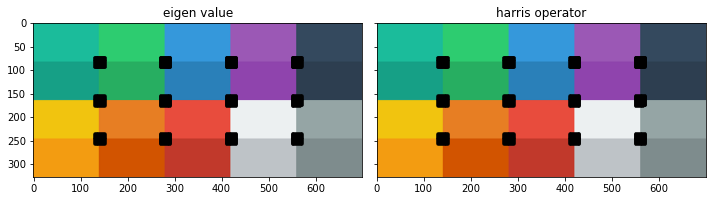

In [224]:
type_list = ['eigen value', 'harris operator']
fig, ax = plt.subplots(1,2, figsize=(10,20), sharey=True)

for i, k in enumerate(corner_list):
    ax[i].imshow(img)
    ax[i].scatter(k[:,1], k[:,0], marker='o', c= 'black', s=1)
    ax[i].set_title(type_list[i])

plt.tight_layout()
plt.show()